### Modelagem Direta Acústico Explicito - Simple Seismic Acquisition Pattern

__________________

In [1]:
%matplotlib inline

In [2]:
from matplotlib import pyplot as plt
import matplotlib.animation
import matplotlib
import numpy as np
from numba import njit, prange

## Modelagem Direta

$$ p_{ik}^{n+1} = \beta c_{ik}^2 \left[ -p_{i-2k}^n+16p_{i-1k}^n+16p_{i+1k}^n-p_{i+2k}^n -p_{ik-2}^n+16p_{ik-1}^n+16p_{ik+1}^n-p_{ik+2}^n-60p_{ik}^n \right] +\Delta t^2 c_{ik}^2 \ s_{ik}^n +2p_{ik}^n-p_{ik}^{n-1}  $$

#### Loop simples

In [3]:
@njit(parallel=True)
def stepScalar(u_tp1, u_t, u_tm1, c, x1, x2, z1, z2, dx, dz, dt):
    """
    Perform a single time step in the Finite Difference solution for scalar
    waves 4th order in space
    """    
    cdz = (dt/dz)**2
    cdx = (dt/dx)**2

    for i in prange(z1, z2):
        for j in prange(x1, x2):
            u_tp1[i,j] = (2.*u_t[i,j] - u_tm1[i,j]
                + (c[i,j]**2)*(
                    cdx*(-u_t[i,j + 2] + 16.*u_t[i,j + 1] - 30.*u_t[i,j] +
                    16.*u_t[i,j - 1] - u_t[i,j - 2])/12. +
                    cdz*(-u_t[i + 2,j] + 16.*u_t[i + 1,j] - 30.*u_t[i,j] +
                    16.*u_t[i - 1,j] - u_t[i - 2,j])/12.))    

##### Absorção 2 ordem

In [4]:
@njit(parallel=True)
def nonreflexive2nd(u_tp1, u_t, u_tm1, c, nx, nz, dx, dz, dt):
    """
    Apply the boundary conditions: free-surface at top, transparent in the borders
    4th order (+2-2) indexes
    Uses Reynolds, A. C. - Boundary conditions for numerical solution of wave propagation problems
    Geophysics p 1099-1110 - 1978
    We apply 1D reynolds at -2/-1 and +2/+1 respectively
    """
    for i in range(nz):
        # left
        for p in range(2):
                u_tp1[i, p] = ( u_t[i, p] + u_t[i, p+1] - u_tm1[i,p+1] +
                (c[i, p]*dt/dx)*(u_t[i, p+1] - u_t[i, p] - u_tm1[i, p+2] + u_tm1[i, p+1])
                )
        #right
        for p in range(2):
            p = 1-p            
            u_tp1[i, nx-2+p] = ( u_t[i, nx-2+p] + u_t[i, nx-3+p] - u_tm1[i, nx-3+p] -
                (c[i, nx-2+p]*dt/dx)*(u_t[i, nx-2+p] - u_t[i, nx-3+p] - u_tm1[i, nx-3+p] + u_tm1[i, nx-4+p])
                )
    # Down
    for i in range(nx):
        for p in range(2):
            p = 1-p
            u_tp1[nz-2+p, i] = ( u_t[nz-2+p, i] + u_t[nz-3+p, i] - u_tm1[nz-3+p, i] -
                    (c[nz-2+p, i]*dt/dz)*(u_t[nz-2+p, i] - u_t[nz-3+p, i] - u_tm1[nz-3+p, i] + u_tm1[nz-4+p, i])
                    )
        # Up
        for p in range(2):            
            u_tp1[p, i] = ( u_t[p, i] + u_t[p+1, i] - u_tm1[p+1, i] +
                    (c[p, i]*dt/dz)*(u_t[p+1, i] - u_t[p, i] - u_tm1[p+2, i] + u_tm1[p+1, i])
                    )

##### Damping Cerjan

$$ e^{-\alpha(i-nx)} $$

Text(0.5, 0, 'grid points')

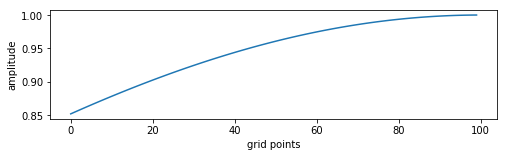

In [5]:
decay=0.004
pad=100
ix = np.arange(0, pad)
plt.figure(figsize=(8,2))
plt.plot(ix, np.exp(-(decay*(pad-ix))**2))
plt.ylabel('amplitude')
plt.xlabel('grid points')

In [6]:
@njit(parallel=True)
def applyDamping(array, nx, nz, pad, decay):
    """
    Apply a decay factor to the values of the array in the padding region.
    """
    # Damping on the left
    for i in prange(nz):
        for j in range(pad):
            array[i,j] *= np.exp(-((decay*(pad - j))**2))
    # Damping on the right
    for i in prange(nz):
        for j in range(nx - pad, nx):
            array[i,j] *= np.exp(-((decay*(j - nx + pad))**2))
    # Damping on the bottom
    for i in prange(nz - pad, nz): # down
        for j in range(nx):
            array[i,j] *= np.exp(-((decay*(i - nz + pad))**2))
    # Damping up
    for i in prange(pad): # down
        for j in range(nx): # left-right
            array[i,j] *= np.exp(-((decay*(pad - i))**2))

### modelo de velocidade

In [7]:
from scipy.ndimage import gaussian_filter

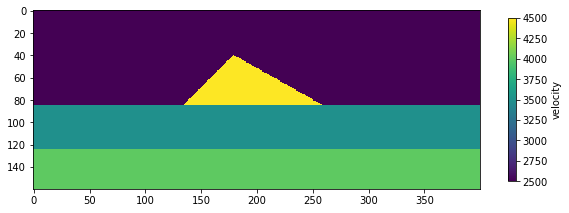

In [8]:
import numpy as np
from PIL import Image
# loading velocity from wedge image file
filename=r'wedge.tif'
img = Image.open(filename)
img.load()
img = img.convert('I') # gray scale, convert format
velocity  = np.asarray(img, dtype=np.float32)
velocity[:][velocity[:] == 255.0] = 2500.0
velocity[:][velocity[:] == 0.0] = 4500.0
velocity[:][velocity[:] == 146.0] = 3500.0
velocity[:][velocity[:] == 36.0] = 4000.0
plt.figure(figsize=(10,5))
im = plt.imshow(velocity)
plt.colorbar(im,  shrink=0.60, pad = 0.05, label=u'velocity')

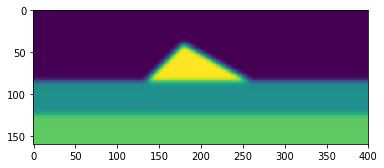

In [9]:
smoothed = np.zeros(velocity.shape)
sigma = 3 # I have no idea what a reasonable value is here
gaussian_filter(velocity, sigma, output = smoothed)
plt.imshow(smoothed)

velocity = smoothed

### Source Positions

- Assuming dx=dz=ds=10 m discretization in space in z and x
- 400x10 = 4 km maximum size model
- 9 shots
  - shot spacing 40x10 m = 400 m  
  - split-spread 40 channels each side offsets 10 to 40x10 m = 10 to 400 meters
  - receiver spacing 10 m

In [10]:
sz = np.zeros(9, dtype=int)
sx = np.linspace(40, 360, 9, dtype=int)

In [11]:
sx

array([ 40,  80, 120, 160, 200, 240, 280, 320, 360])

In [12]:
@njit
def ricker(t, td, f):
    """amplitude unitária"""
    t = (t - td)
    aux = (1 - 2*(np.pi*f*t)**2)
    return aux*np.exp(-(np.pi*f*t)**2)

def params(fcut, c):
    """
    A partir da frequencia máxima na fonte `fcut` e do 
    campo de velocidades `c` calcula:
    ds, f central, t delay, dt time step
    """    
    # fcut máxima frequência na fonte
    f = 2*fcut/(3*np.sqrt(np.pi)) # f central
    td = 2*np.sqrt(np.pi)/fcut # time delay    
    lmin = np.min(c)/fcut # lambda min
    ds = 0.95*lmin/5. # grid spacing to avoid spatial alias
    # round to nearest 10 smaller
    ds = int(ds/10)*10
    assert ds < lmin/5. # alford
    dt = (1-1e-4)*ds*np.sqrt(3)/(np.sqrt(8)*np.max(c))  # "quaaase" no limite (menor erro)
    return ds, f, td, dt

nz, nx = velocity.shape
npad = 40 # regiao absorcao
# segunda ordem no espaço stencial requer +2+2 pontos cada dimensao
# padding *2 cada dimensao
# padd velocity model with border values
padvel = np.pad(velocity, [npad+2*2, npad+2*2],  mode='edge')
nz, nx = padvel.shape
# correct source positions
sx += npad + 2
sz += npad + 2

c = padvel
# campos de pressao em n e n+1 ou n-1
p = np.zeros((2, nz, nx)) # n e n+1 ou n-1
# parametros da simulacao fonte de x0 Hz no máxxximoo...
ds, f, td, dt = params(45., c)
# numero de iteracoes a partir de duracao da simulacao
duracao = 2.50 # segundo
nt = int(duracao/dt)

print('Ds: ', ds, 'f. central :', f, 'delay : ', td, 'dt: ',  dt, ' nt: ', nt)

Ds:  10 f. central : 16.925687506432688 delay :  0.07877572670691181 dt:  0.0013606915521160552  nt:  1837


# Simulation Loop

In [13]:
@njit
def runSimulation(params):
    ds, dt, c, nx, nz, nt, npad, sz, sx, td, f = params
    p = np.zeros((2, nz, nx)) # n e n+1 ou n-1
    snaps = np.zeros((nt, nz, nx))
    for i in range(nt):
        # para evitar um painel a mais : pilha de paineis 
        t, tm1 = i%2, (i+1)%2
        tp1 = tm1  

        nonreflexive2nd(p[tp1], p[t], p[tm1], c, nx, nz, ds, ds, dt)
        stepScalar(p[tp1], p[t], p[tm1], c, 2, nx-2, 2, nz-2, ds, ds, dt)

        applyDamping(p[tm1], nx, nz, npad, 0.004)
        applyDamping(p[t], nx, nz, npad, 0.004)  
        
        p[tp1, sz, sx] -= ((c[sz, sx]*dt)**2)*ricker(i*dt, td, f)  
        # simulation snapshots array            
        snaps[i, :] = p[t]    
    return snaps

### Run 9 shots

Extracting channels 

In [14]:
%%time 
shots = np.zeros((9, 80, nt))
for i in range(9):
    sim = runSimulation((ds, dt, c, nx, nz, nt, npad, sz[i], sx[i], td, f))
    s0 = sx[i]-40#first channel/station
    sn = sx[i]+40# last channel/station 
    shot = sim[:, sz[0], s0:sn]
    shots[i, :]  = shot.T[:] # tranpose

CPU times: user 48.5 s, sys: 11 s, total: 59.5 s
Wall time: 22.1 s


### Plot last 4 shots

In [15]:
shots.shape

(9, 80, 1837)

In [16]:
perc = np.percentile(shots[-4], [3])

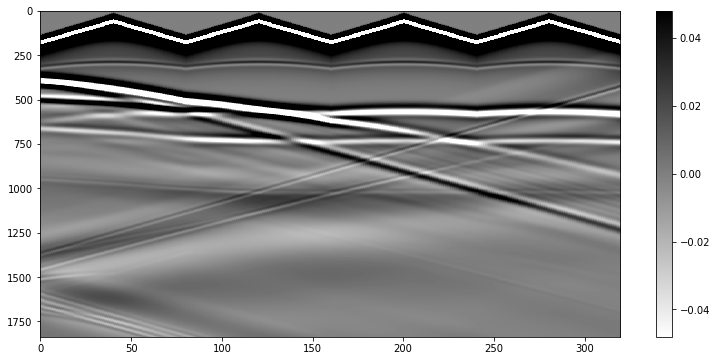

In [17]:
plt.figure(figsize=(13, 6))
plt.imshow(shots[-4:].reshape((80*4, nt)).T, aspect='auto', vmin=perc[0], vmax=-perc[0], cmap='gray_r')
plt.colorbar()

## Animation last shot

In [18]:
plt.rcParams['animation.embed_limit'] = 1024 # in MB

In [19]:
import matplotlib
from matplotlib import animation

snaps = sim
apad = npad+2 # 2 additional points space
pmin = np.percentile(snaps, [1])
ext = [0, nx*ds, nz*ds, 0]
fig = plt.figure(figsize=(12,6))
im = plt.imshow(snaps[0,:,:], cmap='gray_r', interpolation='none', vmin=-pmin, vmax=pmin, extent=ext, alpha=0.7)
# boundary without cerjan absortion
plt.plot([apad*ds, (nx-apad)*ds, (nx-apad)*ds, apad*ds, apad*ds], 
         [apad*ds, apad*ds, (nz-apad)*ds, (nz-apad)*ds, (apad)*ds], 'b') 
plt.colorbar(im,  shrink=0.8, pad = 0.01, aspect=10, label=u'amplitude')
plt.xlabel('x (m)')
plt.ylabel('z (m)')
title = plt.title(u'Campo de Pressão')
#sns.despine()
plt.tight_layout()
plt.close()

def animate(i):
    im.set_data(snaps[i*4, :,:])

ani = animation.FuncAnimation(fig, animate, frames=int(snaps.shape[0]/4))

from IPython.display import HTML
HTML(ani.to_jshtml())

### Save to binary file

before resample to 2 ms

In [ ]:
shots = shots.reshape((80*9, nt)).T

In [28]:
shots.shape

(1250, 720)

In [22]:
import fractions
from scipy import signal
factor=dt/2e-3 # resampling factor
frac = fractions.Fraction(factor).limit_denominator(10000)
print('resampling factor | rational aproximational | error')
factor, frac.numerator/frac.denominator, factor-frac.numerator/frac.denominator

resampling factor | rational aproximational | error


(0.6803457760580276, 0.6803457973127799, -2.1254752291532952e-08)

In [23]:
# better accuracy on dt than `resample`
shots = signal.resample_poly(shots, frac.numerator, frac.denominator, axis=0)

/home/andre/anaconda3/lib/python3.6/site-packages/scipy/signal/signaltools.py:2383: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return y[keep]


In [24]:
shots.shape #  file size in bytes 1250*720*8 = 7200000

(1250, 720)

In [32]:
shots.tofile('9shots2ms.bin') 